# Load code from Github

In [ ]:
!git clone https://github.com/X1nzhe/CXRGenAI.git

Cloning into 'CXRGenAI'...
remote: Enumerating objects: 597, done.
remote: Counting objects: 100% (209/209), done.
remote: Compressing objects: 100% (159/159), done.
remote: Total 597 (delta 111), reused 109 (delta 50), pack-reused 388 (from 1)
Receiving objects: 100% (597/597), 91.72 KiB | 15.29 MiB/s, done.
Resolving deltas: 100% (411/411), done.


# Install Requirments

In [ ]:
!pip install -q -r /content/CXRGenAI/requirements.txt

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 165.1/165.1 kB 14.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 6.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.9/89.9 kB 8.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.5/40.5 kB 2.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.0/62.0 kB 5.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.0/44.0 kB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.7/2.7 MB 83.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.9/4.9 MB 112.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.3/133.3 kB 14.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.0/5.0 MB 116.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.5/84.5 kB 9.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.

# Quick Fine-tune (With Parameters Config for Development/Debug)

In [ ]:
# IMPORTANT NOTICE: The project was developed and has been tested on A100 or L4 GPUs on Google Colab. Other GPU/TPU hardwares MAY NOT be compatible, e.g. T4 GPU.

# --env: Runtime environment. By default, it set to 'product'. Another option is 'dev'
# --mode: The mode of how would you like to use the software, chosing 'train' or 'generate'
# --model_path: Path to pre-trained model（'generate' mode only)
# --description: Text description to generate X-Ray image（'generate' mode only)

# Set '--env' to dev for the using of debug config
!python /content/CXRGenAI/main.py --env dev --mode train

Using device: cuda
2025-04-01 22:37:11.321082: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1743547031.343699    3382 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1743547031.350679    3382 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered

Running with environment: dev

Start model training...
Epochs: 1, K_folds: 2, Batch size: 8, Image width: 128, Image height: 128, Number of inference steps: 20

Checking for Indiana University Chest X-ray Collection dataset...
Download completed: /content/CXRGenAI/data/NLMCXR_png.tgz

Extracting PNG images...
Extracting NLMCXR_png.tgz: 100% 7472/7472 [00:11<00:00, 669.23it/s]
PNG images extracted.


Extracting rep

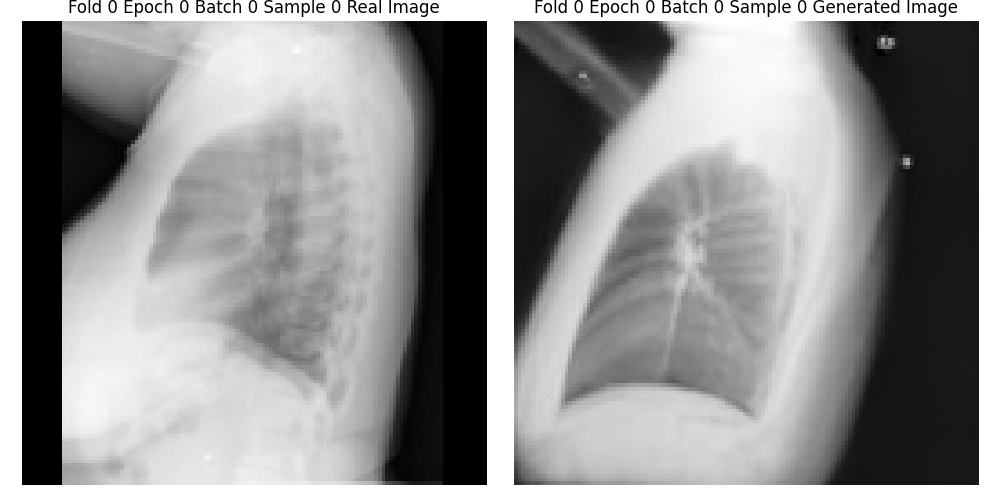

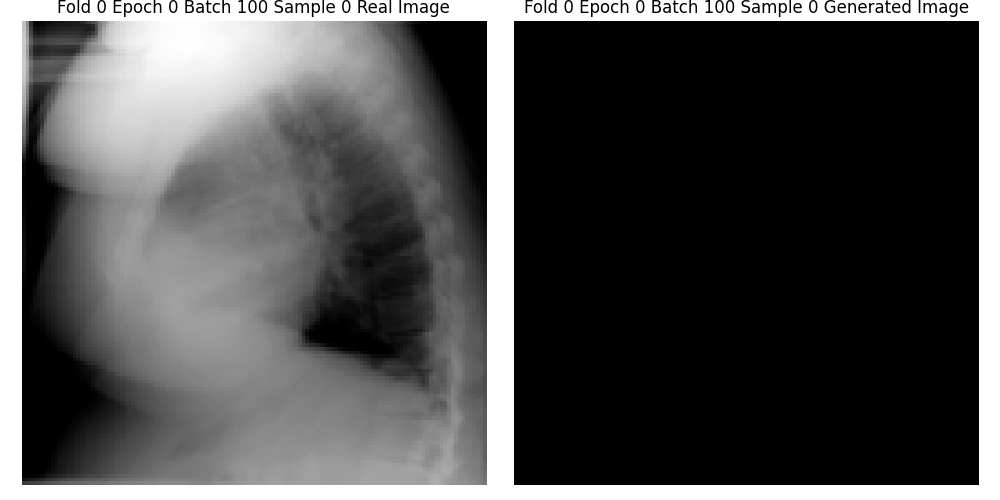

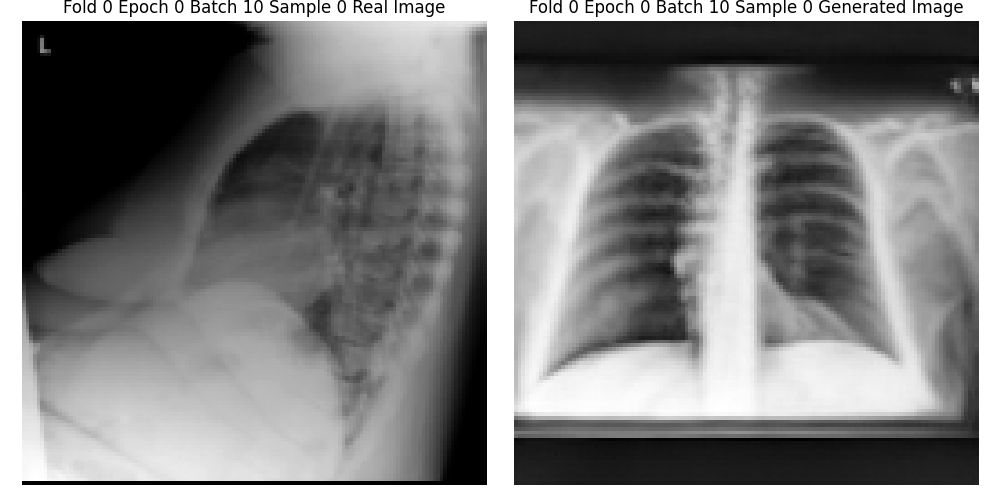

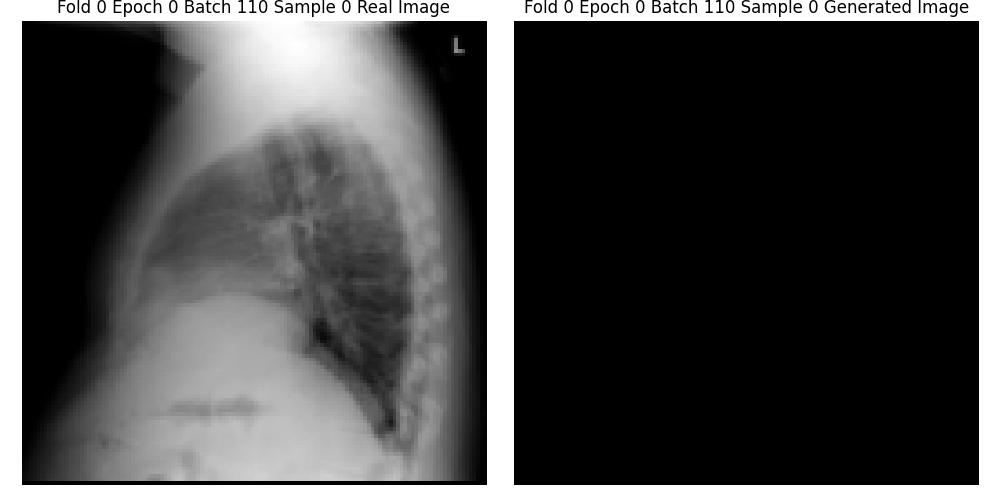

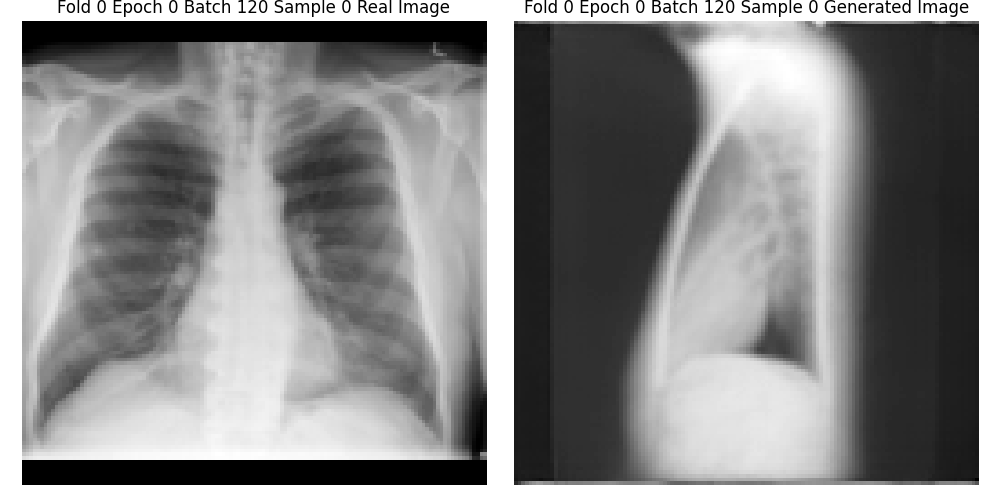

...

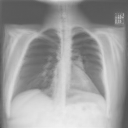

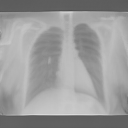

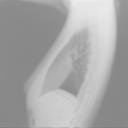

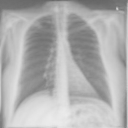

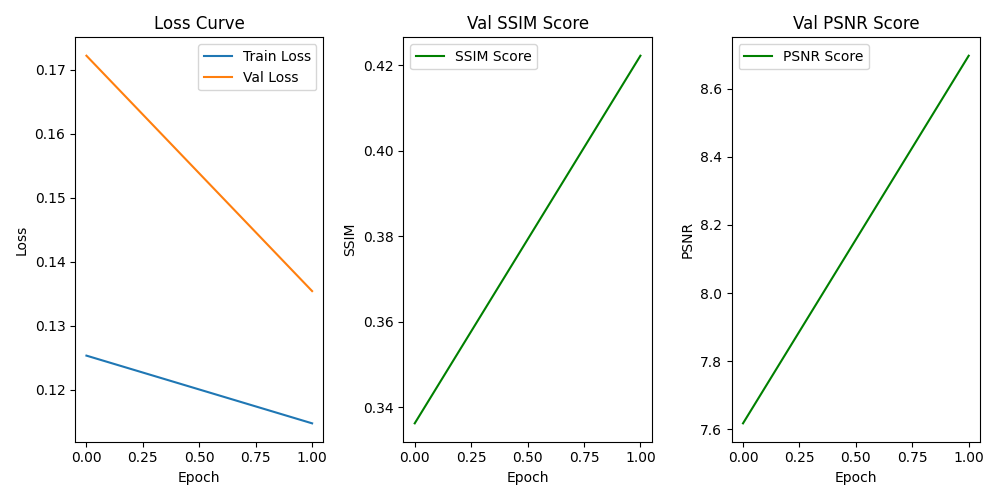

In [ ]:
import os
import glob
from IPython.display import display
from PIL import Image

def show_images_from(image_dir):
    png_files = glob.glob(os.path.join(image_dir, "*.png"))

    if not png_files:
        return

    for img_path in sorted(png_files):
        img = Image.open(img_path)
        display(img)

show_images_from("/content/CXRGenAI/images")

# Fully Fine-tune the model

In [ ]:
# (Optinal) Remove images directory if you were run the code in Debug mode
!rm -rf /content/CXRGenAI/images

In [ ]:
!python /content/CXRGenAI/main.py --mode train

Using device: cuda
2025-03-31 22:35:12.759700: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-03-31 22:35:12.778758: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1743460512.801261   19194 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1743460512.808235   19194 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-03-31 22:35:12.831123: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use 

# Review results

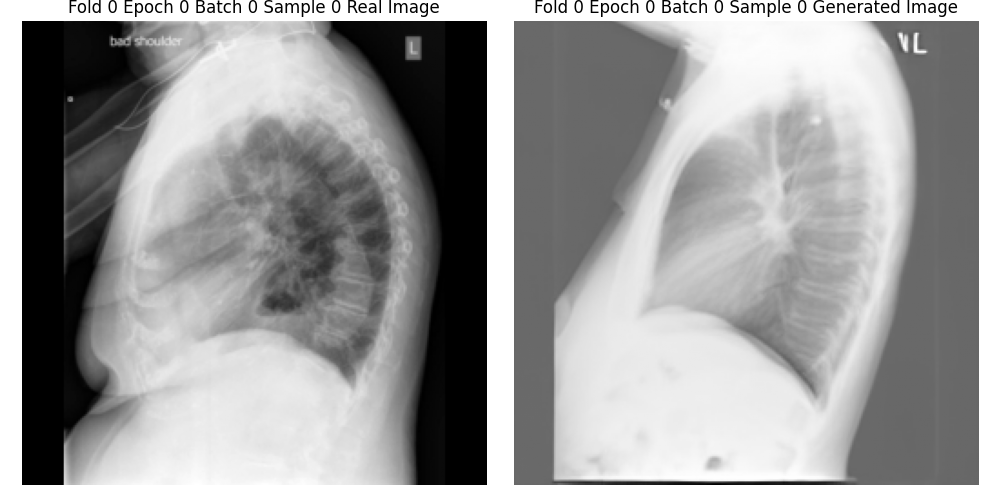

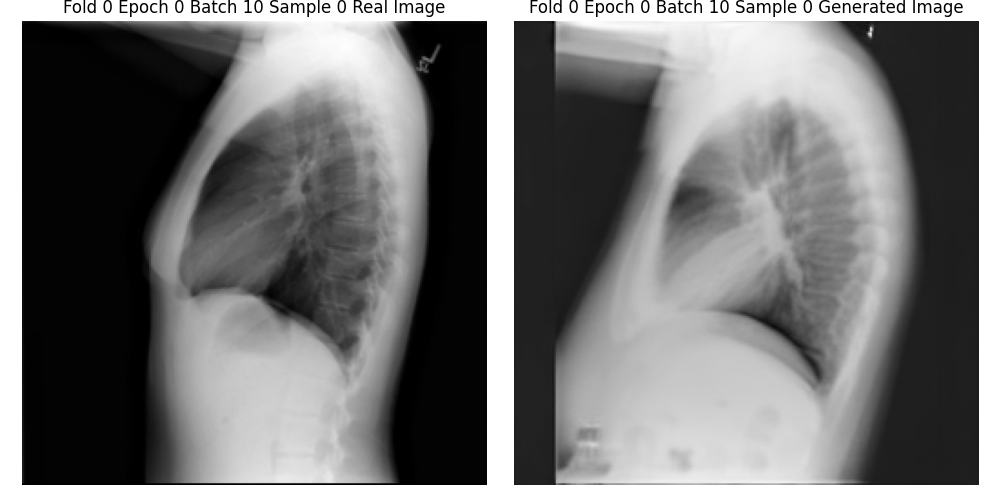

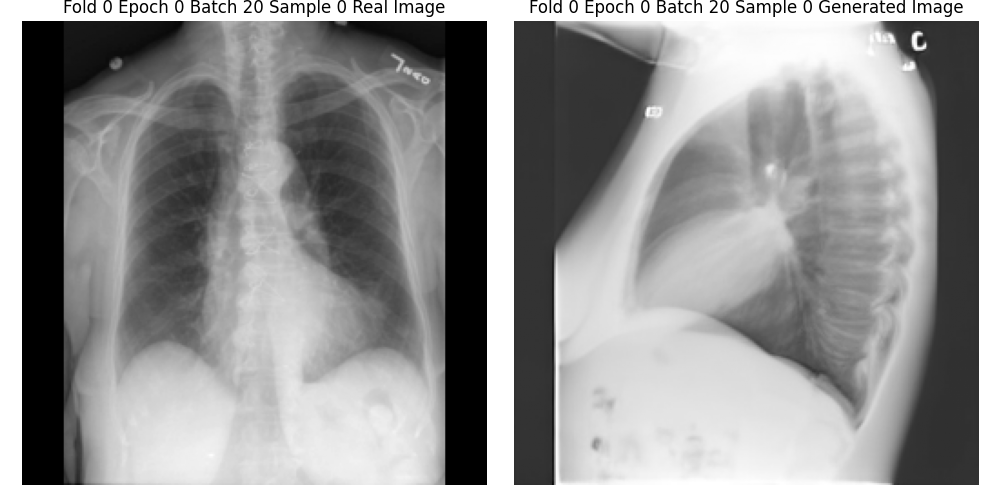

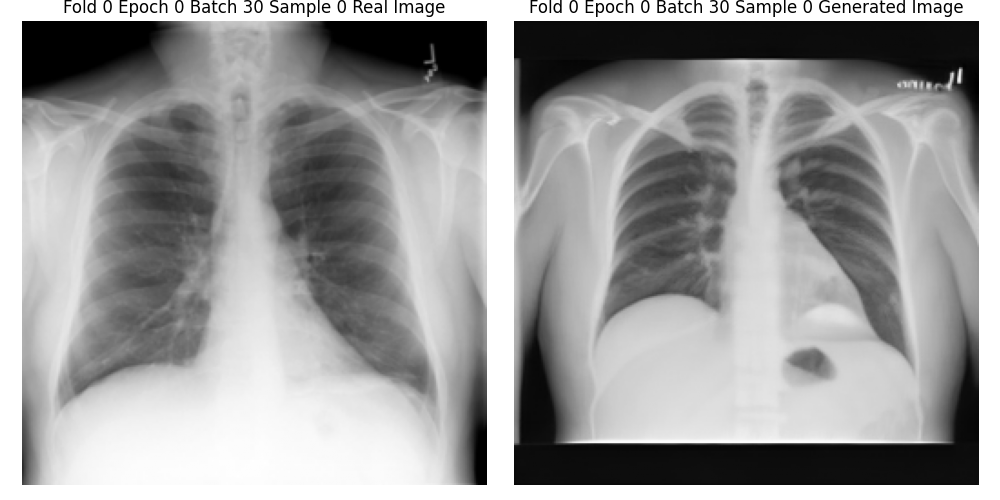

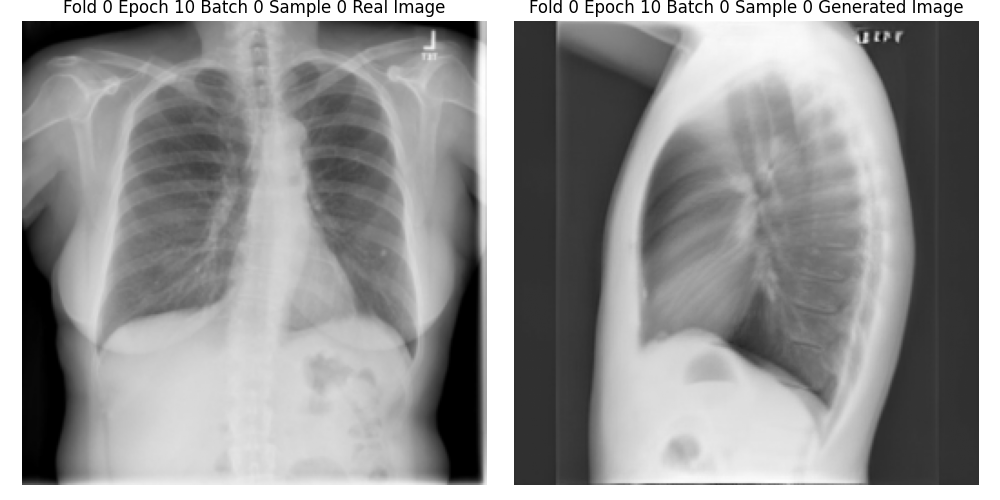

...

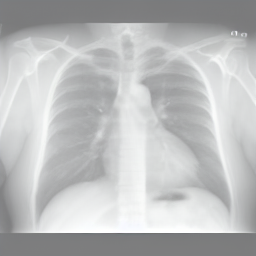

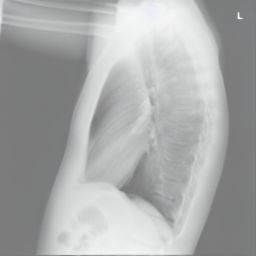

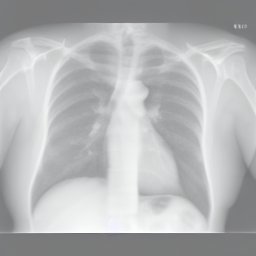

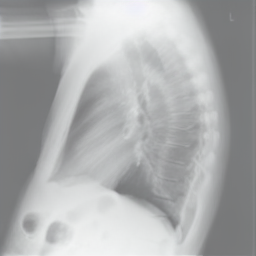

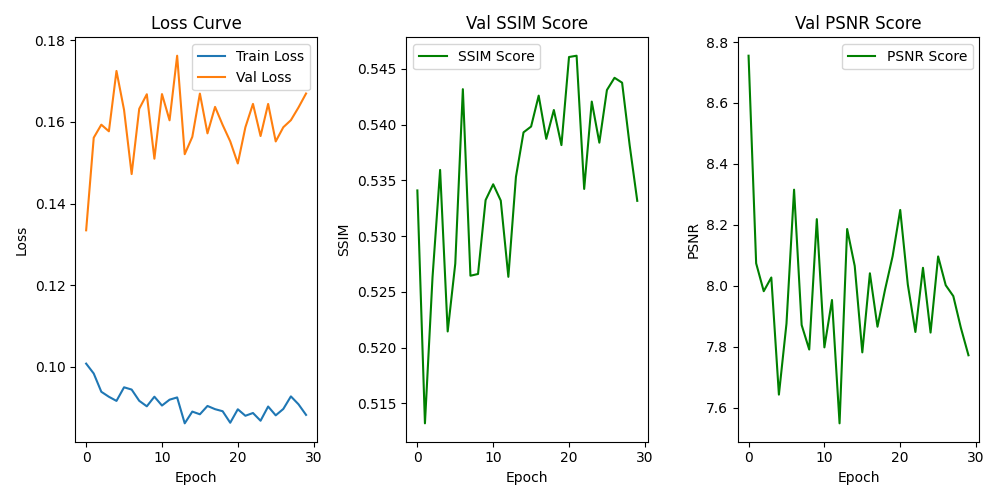

In [ ]:
import os
import glob
from IPython.display import display
from PIL import Image

def show_images_from(image_dir):
    png_files = glob.glob(os.path.join(image_dir, "*.png"))

    if not png_files:
        return

    for img_path in sorted(png_files):
        img = Image.open(img_path)
        display(img)

show_images_from("/content/CXRGenAI/images")

# Save the fine-tuned model and training results

In [ ]:
import shutil

best_model = "best_model_fold3_epoch2"
shutil.make_archive(f"/content/{best_model}", 'zip', f"/content/CXRGenAI/checkpoints/{best_model}")

'/content/best_model_fold3_epoch2.zip'

In [ ]:
from google.colab import files

files.download(f"/content/{best_model}.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
shutil.make_archive("/content/images", 'zip', "/content/CXRGenAI/images/")

'/content/images.zip'

In [ ]:
files.download("/content/images.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import shutil
best = "/content/best_model_fold3_epoch2.zip"
shutil.copy(best, "/content/drive/MyDrive/Colab Notebooks/CSYE7374/Final/")

'/content/drive/MyDrive/Colab Notebooks/CSYE7374/Final/best_model_fold3_epoch2.zip'

# Load pretrained model from Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
zip_path = "/content/drive/MyDrive/Colab Notebooks/CSYE7374/Final/best_model_fold3_epoch2.zip"
extract_folder = "/content/CXRGenAI/checkpoints/best_model"

In [ ]:
import shutil

shutil.unpack_archive(zip_path, extract_folder)

# Generate Xray images with pretrained model

### Example diagnoses
The cardiac silhouette is normal, with no evidence of enlargement. The lungs are clear with no signs of consolidation or effusion. There is no pneumothorax. Mild degenerative changes in the thoracic spine are noted. No acute abnormalities detected.

The cardiomediastinal silhouette is within normal limits, with no evidence of enlargement or mass. The lungs show no signs of pneumothorax or significant opacities. Mild interstitial markings are noted. There are no large pleural effusions. No acute findings.

Marked cardiomegaly with cephalization of pulmonary vessels and bilateral pleural effusions. Perihilar haze suggests developing pulmonary edema. No focal consolidation identified.

Hyperinflated lungs with apical bullae and right apical pneumothorax (15% collapse). Basal reticulation indicates concurrent pulmonary fibrosis. Normal cardiac configuration.


Plate-like atelectasis in the left lower lobe adjacent to a 2.8 cm lobulated mass. Associated airspace consolidation in the lingula. Mediastinal lymphadenopathy present.


In [ ]:
model_path = "/content/CXRGenAI/checkpoints/best_model"
desc_1 = "The cardiomediastinal silhouette is within normal limits, with no evidence of enlargement or mass. The lungs show no signs of pneumothorax or significant opacities. Mild interstitial markings are noted. There are no large pleural effusions. No acute findings."

!python /content/CXRGenAI/main.py --mode generate --model_path {model_path} --description "{desc_1}"

Using device: cuda
2025-04-01 21:11:09.433190: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-04-01 21:11:09.452424: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1743541869.474794  356467 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1743541869.481739  356467 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-04-01 21:11:09.504588: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use 

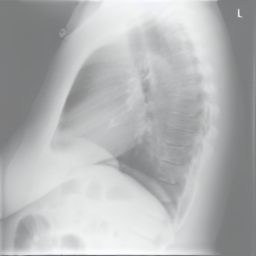

In [ ]:
generated_img_path = "/content/CXRGenAI/images/generated_20250401_211144_263.png"

display(Image.open(generated_img_path))

In [ ]:
desc_2 = "The cardiomediastinal silhouette is within normal limits, with no evidence of enlargement or mass. The lungs show no signs of pneumothorax or significant opacities. Mild interstitial markings are noted. There are no large pleural effusions. No acute findings."
!python /content/CXRGenAI/main.py --mode generate --model_path {model_path} --description "{desc_2}"

Using device: cuda
2025-04-01 21:16:24.946573: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-04-01 21:16:24.965859: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1743542184.988414  357859 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1743542184.995320  357859 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-04-01 21:16:25.018024: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use 

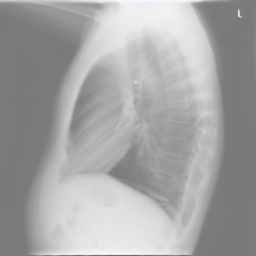

In [ ]:
generated_img_path = "/content/CXRGenAI/images/generated_20250401_211700_375.png"

display(Image.open(generated_img_path))

In [ ]:
desc_3 = "Hyperinflated lungs with apical bullae and right apical pneumothorax (15% collapse). Basal reticulation indicates concurrent pulmonary fibrosis. Normal cardiac configuration."
!python /content/CXRGenAI/main.py --mode generate --model_path {model_path} --description "{desc_3}"

Using device: cuda
2025-04-01 21:20:05.824860: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-04-01 21:20:05.844253: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1743542405.867276  358849 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1743542405.874268  358849 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-04-01 21:20:05.897295: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use 

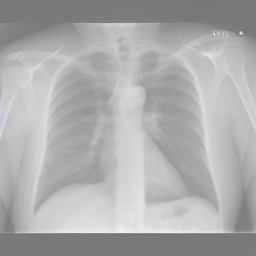

In [ ]:
generated_img_path = "/content/CXRGenAI/images/generated_20250401_212041_752.png"

display(Image.open(generated_img_path))